# Hazard Predictions

## The Challenge 

### Automatic Hazard Detection  on Transverse Cirrus Bands (TCB)
#### Hurricanes | Tunderstorms | Atmospheric jets

TCBs are bands of clouds oriented perpendicular to the atmospheric flow in which they are embedded. TCBs are often an indicator of strong turbulence and often associated with severe weather such as hurricanes and thunderstorms or atmospheric jets.

Transverse Cirrus Bands Data: s3://impact-datashare/transverse_bands/
        
        

### Imports

In [1]:
!conda activate skyfolks-env

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams["figure.figsize"] = (15, 10)
plt.rcParams["figure.dpi"] = 125
plt.rcParams["font.size"] = 14
plt.rcParams['font.family'] = ['sans-serif']
plt.rcParams['font.sans-serif'] = ['DejaVu Sans']
plt.style.use('ggplot')
sns.set_style("whitegrid", {'axes.grid': False})
plt.rcParams['image.cmap'] = 'gray' # grayscale looks better

In [2]:
from pathlib import Path
import numpy as np
import pandas as pd
import os
from skimage.io import imread as imread
from skimage.util import montage
from PIL import Image
montage_rgb = lambda x: np.stack([montage(x[:, :, :, i]) for i in range(x.shape[3])], -1)
from skimage.color import label2rgb

###  Reading Data

REUSE dataset generator and augmentations from Examples
Link: https://github.com/nasa/spaceapps-phenomena_detection/blob/dev/examples/ml_model_demo_1.ipynb

Apply the logic to the Hurricane Dataset | Transverse Cirrus Bands (TCB)


This is used to push subsets of input images in memory for Keras so that there is no out of memory error during Training phase

In [3]:
montage_rgb = lambda x: np.stack([montage(x[:, :, :, i]) for i in range(x.shape[3])], -1)

image_dir = Path('.') / 'data' / 'transverse_bands'
mapping_file = Path('.') / 'data' / 'list_of_images.json'
image_df = pd.read_json(mapping_file)

image_df['is_hurricane'] = image_df['path'].map(lambda x: "yes" in x) 

image_df.sample(3)


,path,is_hurricane
4781,data/transverse_bands/no/not_bands1854.jpg,False
5046,data/transverse_bands/no/not_bands2123.png,False
2924,data/transverse_bands/no/77_18-2011-07-17-6-0....,False


In [4]:
image_df.describe()

,path,is_hurricane
count,6802,6802
unique,6801,2
top,data/transverse_bands/yes/0_11-2011-07-17-6-0....,False
freq,2,4901


In [5]:
image_df.head()

,path,is_hurricane
0,data/transverse_bands/yes/0_11-2011-07-17-6-0....,True
1,data/transverse_bands/yes/0_11-2011-07-17-6-0....,True
10,data/transverse_bands/yes/12_9-2010-05-12-6-0....,True
100,data/transverse_bands/yes/38_11-2017-01-08-6-0...,True
1000,data/transverse_bands/yes/bands0844.png,True


In [6]:
print(image_df['path'].map(lambda x: Path(x).exists()).value_counts()) # make sure everything is found

True    6802
Name: path, dtype: int64


In [7]:
image_df['is_hurricane'].value_counts()

False    4901
True     1901
Name: is_hurricane, dtype: int64

In [8]:
from sklearn.model_selection import train_test_split
train_df = image_df
train_df.reset_index(inplace=True)
print(train_df.shape[0], 'training images')

6802 training images


In [9]:
image_df.index

RangeIndex(start=0, stop=6802, step=1)

In [27]:
train_x_vec = np.stack(train_df[['id', 'path']], 0)
train_y_vec = np.stack(train_df['is_hurricane'], 0)
print(train_x_vec.shape, '->', train_y_vec.shape)

(2,) -> (6802,)


In [10]:
image_df.insert(0, 'id', image_df.index)

In [11]:
image_df

,id,index,path,is_hurricane
0,0,0,data/transverse_bands/yes/0_11-2011-07-17-6-0....,True
1,1,1,data/transverse_bands/yes/0_11-2011-07-17-6-0....,True
2,2,10,data/transverse_bands/yes/12_9-2010-05-12-6-0....,True
3,3,100,data/transverse_bands/yes/38_11-2017-01-08-6-0...,True
4,4,1000,data/transverse_bands/yes/bands0844.png,True
...,...,...,...,...
6797,6797,995,data/transverse_bands/yes/bands0839.jpg,True
6798,6798,996,data/transverse_bands/yes/bands0840.png,True
6799,6799,997,data/transverse_bands/yes/bands0841.png,True
6800,6800,998,data/transverse_bands/yes/bands0842.jpg,True


In [12]:
from PIL import Image

def get_image_pixels(imagePath):
    im = Image.open(imagePath, 'r')
    width, height = im.size
    pixel_values = list(im.getdata())

    return pixel_values

In [ ]:
image_df['image_rgb'] = [ get_image_pixels(x) for x in image_df['path'] ]

In [3]:
image_df.head()

NameError: name 'image_df' is not defined

### Data Cleaning

- Extract color features 
- reduce color noise
- run PCA to sample the data


In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
plt.rcParams["figure.figsize"] = (6, 6)
plt.rcParams["figure.dpi"] = 200
plt.rcParams["font.size"] = 14
plt.rcParams['font.family'] = ['sans-serif']
plt.rcParams['font.sans-serif'] = ['DejaVu Sans']
plt.style.use('ggplot')
sns.set_style("whitegrid", {'axes.grid': False})
plt.rcParams['image.cmap'] = 'viridis'

In [2]:
from pathlib import Path
import pandas as pd
import numpy as np
from PIL import Image
from skimage.io import imread
from skimage.util import montage
from tqdm import tqdm
tqdm.pandas() # hack progressbars into pandas
montage_rgb = lambda x, **kwargs: np.stack([montage(x[:, :, :, i], **kwargs) for i in range(x.shape[3])], -1)

C:\ProgramData\Anaconda3\lib\site-packages\tqdm\std.py:668: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel


In [3]:
satellite_dir = Path('data/transverse_bands')
image_df = pd.DataFrame({'path': list(satellite_dir.glob('**/*.jp*g'))})
image_df.sample(3)

,path
1984,data\transverse_bands\no\not_bands1225.jpg
4989,data\transverse_bands\yes\bands1477.jpg
177,data\transverse_bands\no\18_14-2017-08-04-6-0....


In [4]:
image_df['path'][0].__str__()

'data\\transverse_bands\\no\\0_12-2011-07-17-6-0.56.jpg'

#### Generate the variable is_hurricane if "yes" string is in the path

In [5]:
image_df['is_hurricane'] = image_df['path'].map(lambda x: "yes" in x.__str__()) 
image_df.sample(3)

,path,is_hurricane
3358,data\transverse_bands\no\not_bands3016.jpg,False
3149,data\transverse_bands\no\not_bands2749.jpg,False
4917,data\transverse_bands\yes\bands1345.jpg,True


### Downgrading the IMAGE color spectrum

- Currently have 2^8 | 8-bit  and 3 channel| Red, Green, Blue
- Convert it to a 8-bit format to reduce the colors

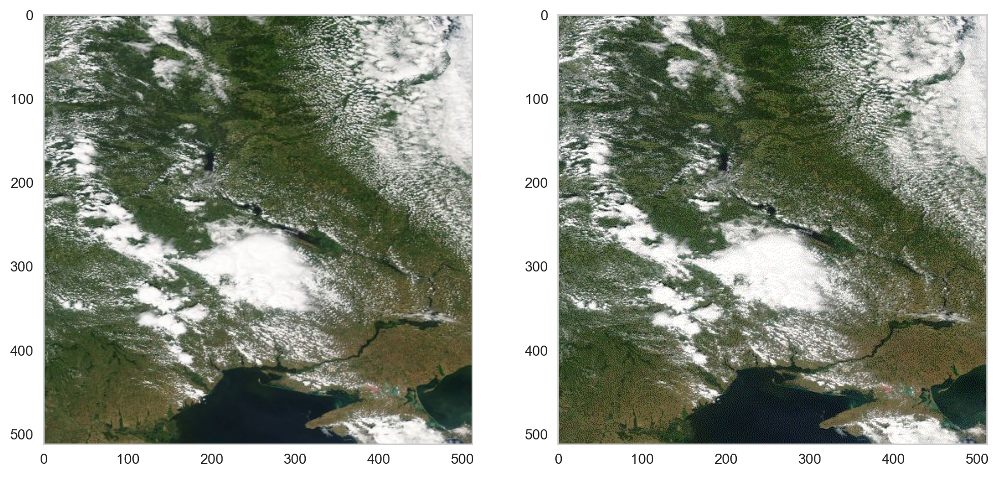

In [11]:
test_image = Image.open(image_df['path'].iloc[2739]) # normal image
# convert to 8bit color (animated GIF) and then back
web_image = test_image.convert('P', palette='WEB', dither=None)
few_color_image = web_image.convert('RGB')
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
ax1.imshow(test_image)
ax2.imshow(few_color_image)

In [12]:
print('Unique colors before', len(set([tuple(rgb) for rgb in np.array(test_image).reshape((-1, 3))])))
print('Unique colors after', len(set([tuple(rgb) for rgb in np.array(few_color_image).reshape((-1, 3))])))

Unique colors before 39088
Unique colors after 54


### Take a look at the RGBs patterns

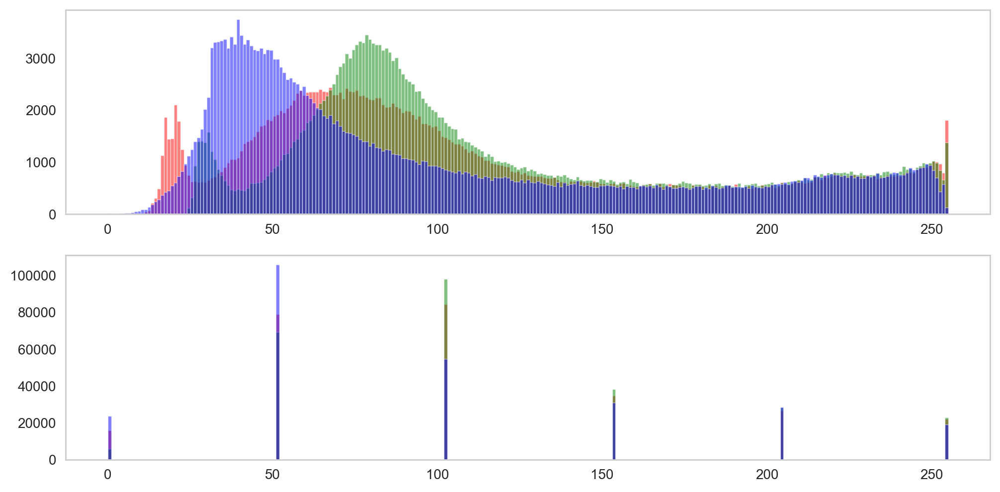

In [52]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 6))
for c_channel, c_name in enumerate(['red', 'green', 'blue']):
    ax1.hist(np.array(test_image)[:, :, c_channel].ravel(), 
             color=c_name[0], 
             label=c_name, 
             bins=np.arange(256), 
             alpha=0.5)
    ax2.hist(np.array(few_color_image)[:, :, c_channel].ravel(), 
             color=c_name[0], 
             label=c_name, 
             bins=np.arange(256), 
             alpha=0.5)

In [13]:
idx_to_color = np.array(web_image.getpalette()).reshape((-1, 3))/255.0

Text(0, 0.5, 'Pixel Count')

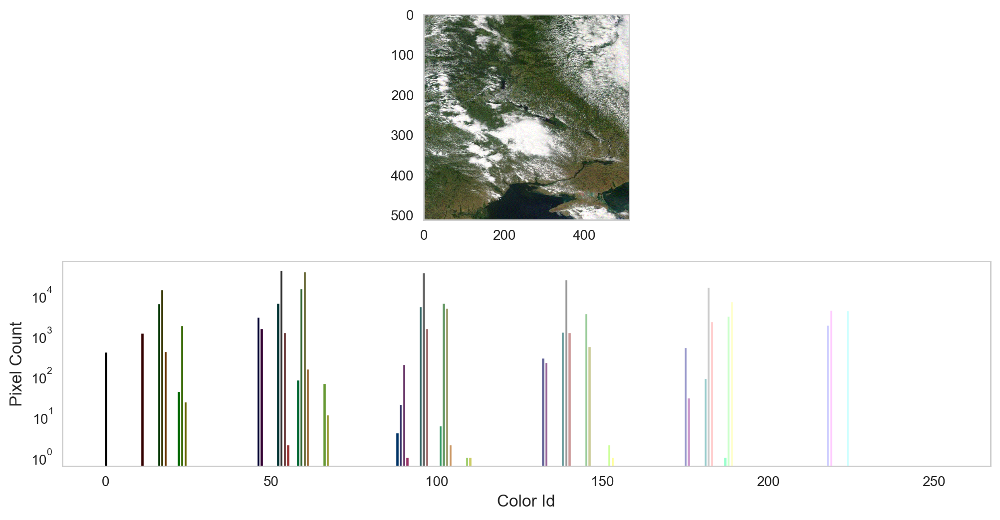

In [14]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 6))
ax1.imshow(few_color_image)
counts, bins = np.histogram(web_image, bins=np.arange(256))
for i in range(counts.shape[0]):
    ax2.bar(bins[i], counts[i], color=idx_to_color[i])
ax2.set_yscale('log')
ax2.set_xlabel('Color Id')
ax2.set_ylabel('Pixel Count')

In [15]:
def color_count_feature(in_path):
    raw_image = Image.open(in_path) 
    web_image = raw_image.convert('P', palette='WEB', dither=None)
    counts, bins = np.histogram(np.array(web_image).ravel(), bins=np.arange(256))
    return counts*1.0/np.prod(web_image.size) # normalize output

### Process the images and extract color features

In [16]:
%%time
image_df['color_features'] = image_df['path'].progress_map(color_count_feature)

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5144/5144 [07:40<00:00, 11.16it/s]

Wall time: 7min 40s


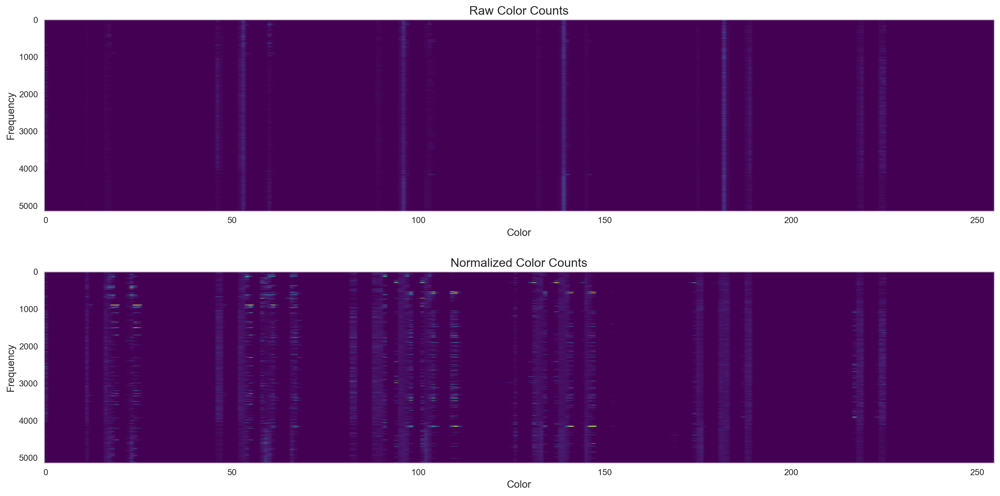

In [17]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(20, 10))
combined_features = np.stack(image_df['color_features'].values, 0)
ax1.imshow(combined_features)
ax1.set_title('Raw Color Counts')
ax1.set_xlabel('Color')
ax1.set_ylabel('Frequency')
ax1.set_aspect(0.01)
color_wise_average = np.tile(np.mean(combined_features, 0, keepdims=True), (combined_features.shape[0], 1)).clip(1/(128*128), 1)
ax2.imshow(combined_features/color_wise_average, vmin=0.05, vmax=20)
ax2.set_title('Normalized Color Counts')
ax2.set_xlabel('Color')
ax2.set_ylabel('Frequency')
ax2.set_aspect(0.01)


# Run PCA on the combined features
- Helps visualize the data
- Dimension reduction

In [18]:
from sklearn.decomposition import PCA
xy_pca = PCA(n_components=2)
xy_coords = xy_pca.fit_transform(combined_features)
image_df['x'] = xy_coords[:, 0]
image_df['y'] = xy_coords[:, 1]

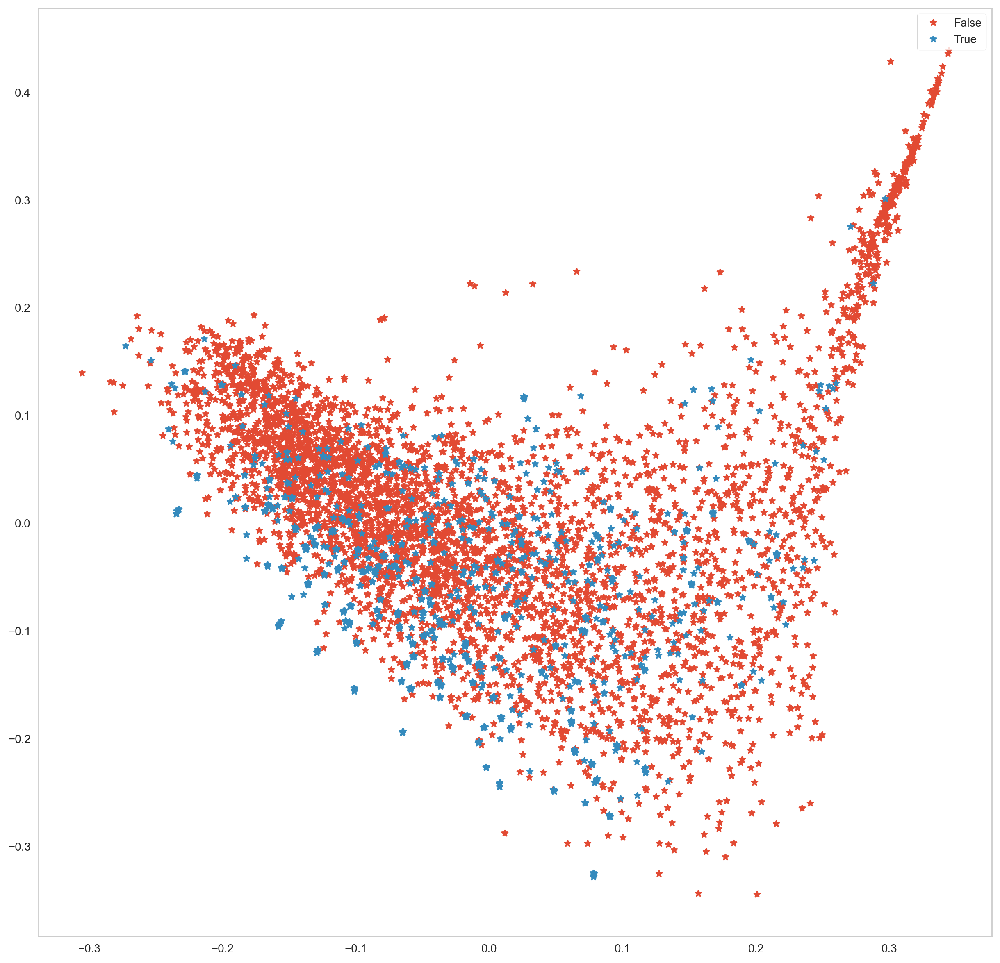

In [21]:
fig, ax1 = plt.subplots(1,1, figsize=(15, 15))
for c_group, c_row in image_df.groupby('is_hurricane'):
    ax1.plot(c_row['x'], c_row['y'], '*', label=c_group)
ax1.legend()

#### Show images grouped by color similarity
- based on the principal components return by PCA

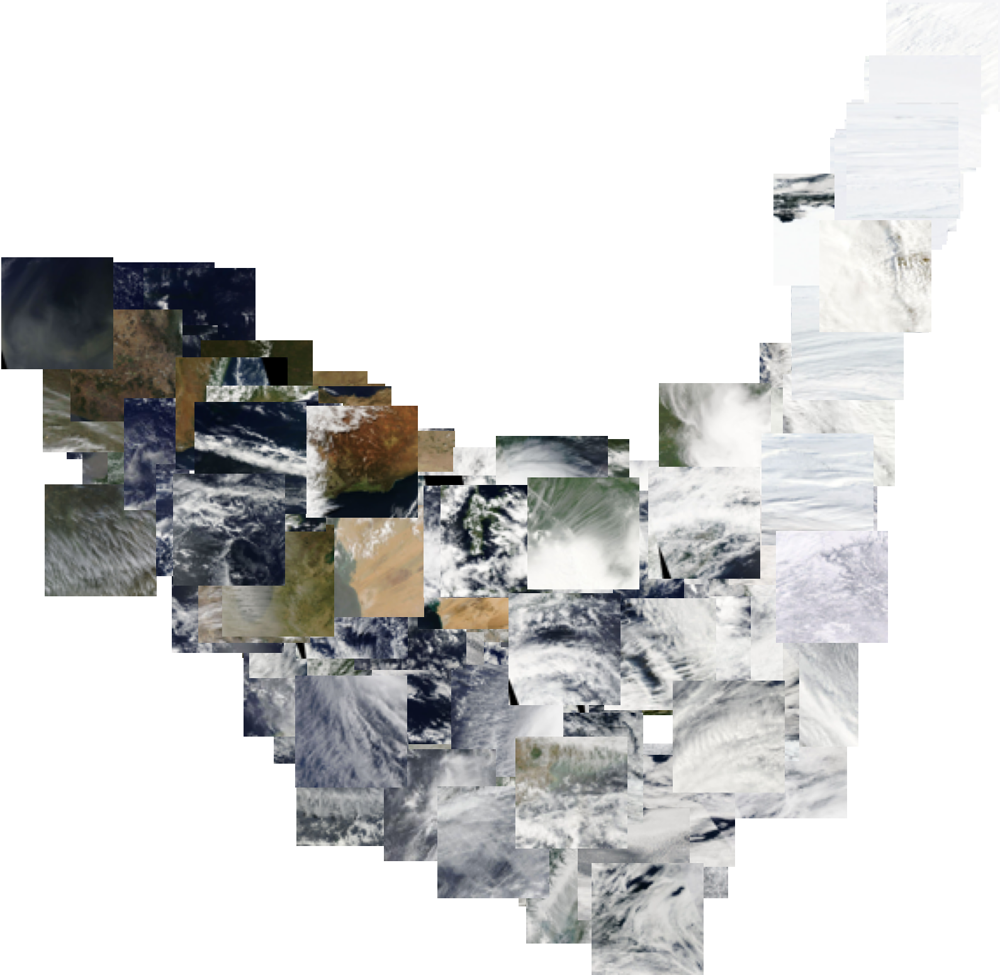

In [22]:
def show_xy_images(in_df, image_zoom=1):
    fig, ax1 = plt.subplots(1,1, figsize=(10, 10))
    artists = []
    for _, c_row in in_df.iterrows():
        c_img = Image.open(c_row['path']).resize((64, 64))
        img = OffsetImage(c_img, zoom=image_zoom)
        ab = AnnotationBbox(img, (c_row['x'], c_row['y']), xycoords='data', frameon=False)
        artists.append(ax1.add_artist(ab))
    ax1.update_datalim(in_df[['x', 'y']])
    ax1.autoscale()
    ax1.axis('off')
show_xy_images(image_df.sample(200))

#### Save Extracted Features

In [23]:
image_df['path'] = image_df['path'].map(str) # saving pathlib objects causes problems
image_df.to_json('color_features.json')

In [24]:
image_df.sample(3)

,path,is_hurricane,color_features,x,y
1545,data\transverse_bands\no\not_bands0666.jpg,False,"[8.392333984375e-05, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.119302,0.046739
1131,data\transverse_bands\no\not_bands0119.jpg,False,"[0.004383087158203125, 0.0, 0.0, 0.0, 0.0, 0.0...",-0.081145,0.060178
1957,data\transverse_bands\no\not_bands1192.jpg,False,"[0.076171875, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....",-0.173909,0.131140


In [25]:
image_df['data_split'] = 'train_another'
image_df['data_split'].value_counts()

train_another    5144
Name: data_split, dtype: int64

### Split data into test/train

In [26]:
from sklearn.model_selection import train_test_split
train_df = image_df.query('data_split=="train_another"')
train_df.reset_index(inplace=True)
print(train_df.shape[0], 'training images')

5144 training images


In [28]:
train_x_vec = np.stack(train_df['color_features'].values, 0)
train_y_vec = np.stack(train_df['is_hurricane'], 0)
print(train_x_vec.shape, '->', train_y_vec.shape)

(5144, 255) -> (5144,)


#### Helper function to show model results

In [29]:
from sklearn.metrics import roc_auc_score, roc_curve, accuracy_score

def show_model_results(in_model, use_split=None, plot_type='swarm'):
    fig, m_axs = plt.subplots(4, 2, figsize=(15, 30))
    m_axs = m_axs.flatten()
    all_rows = []
    ax1 = m_axs[0]
    
    if use_split is None:
        cur_df = image_df.copy()
    else:
        cur_df = image_df.query('data_split=="{}"'.format(use_split)) 
    
    for c_split, example_df in cur_df.groupby('data_split'):
        example_df = example_df.reset_index()
        x_vec = np.stack(example_df['color_features'].values, 0)
        y_vec = np.stack(example_df['is_hurricane'], 0)

        valid_pred = in_model.predict(x_vec)
        tpr, fpr, _ = roc_curve(y_vec[:], valid_pred[:])
        auc = roc_auc_score(y_vec[:], valid_pred[:])
        acc = accuracy_score(y_vec[:], valid_pred[:]>0.5)
        ax1.plot(tpr, fpr, '.-', label='{}, AUC {:0.2f}, Accuracy: {:2.0%}'.format(c_split, auc, acc))
        all_rows += [pd.DataFrame({'class': y_vec[:], 'prediction': np.clip(valid_pred[:], 0, 1), 'type': 'is_hurricane', 
                                  'split': c_split})]
    
    c_all_df = pd.concat(all_rows)
        
    # show example images
    ax1.legend()
    for (_, c_row), (c_ax) in zip(
        example_df.sample(m_axs.shape[0]).iterrows(), 
                               m_axs[1:-1]):
        
        c_ax.imshow(imread(c_row['path']))
        t_yp = in_model.predict(np.expand_dims(c_row['color_features'], 0))
        c_ax.set_title('Class: {}\n Is Hurricane Prediction: {:2.2%}'.format(c_row['is_hurricane'], t_yp[0]))
        c_ax.axis('off')
        
        t_y = np.array(c_row['is_hurricane'])
    
    # nice dataframe of output
    
    ax1 = m_axs[-1]
    if plot_type=='swarm':
        # prevent overplotting
        sns.swarmplot(data=c_all_df.sample(500) if c_all_df.shape[0]>1000 else c_all_df,
                      hue='class', 
                      y='prediction', 
                      x='type', 
                      size=2.0, 
                      ax=ax1)
    elif plot_type=='box':
        sns.boxplot(data=c_all_df, hue='class', y='prediction', x='type', ax=ax1)
    elif plot_type=='violin':
        sns.violinplot(data=c_all_df, hue='class', y='prediction', x='type', ax=ax1)
    ax1.set_ylim(-0.05, 1.05)
    return c_all_df

# Train Model


#### KNeighbors Regressor 
Nearest Neighbor works by finding the most similar case from the training data using the feature vector. We can directly visualize this by showing which training image was being looked at.

In [30]:
from sklearn.neighbors import KNeighborsRegressor
knn = KNeighborsRegressor(n_neighbors=1)
knn.fit(train_x_vec, train_y_vec)

KNeighborsRegressor(n_neighbors=1)

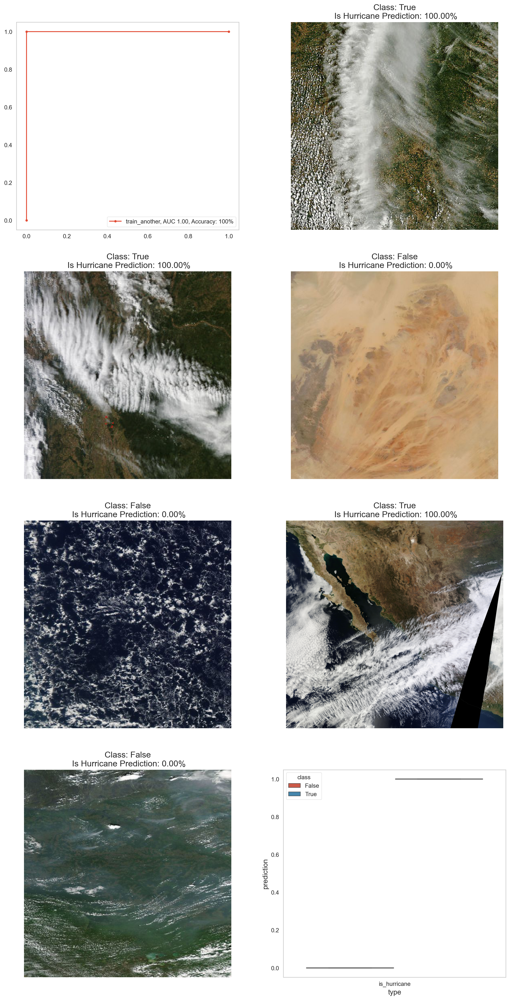

In [31]:
show_model_results(knn, None, plot_type='box');

## Dig deeper

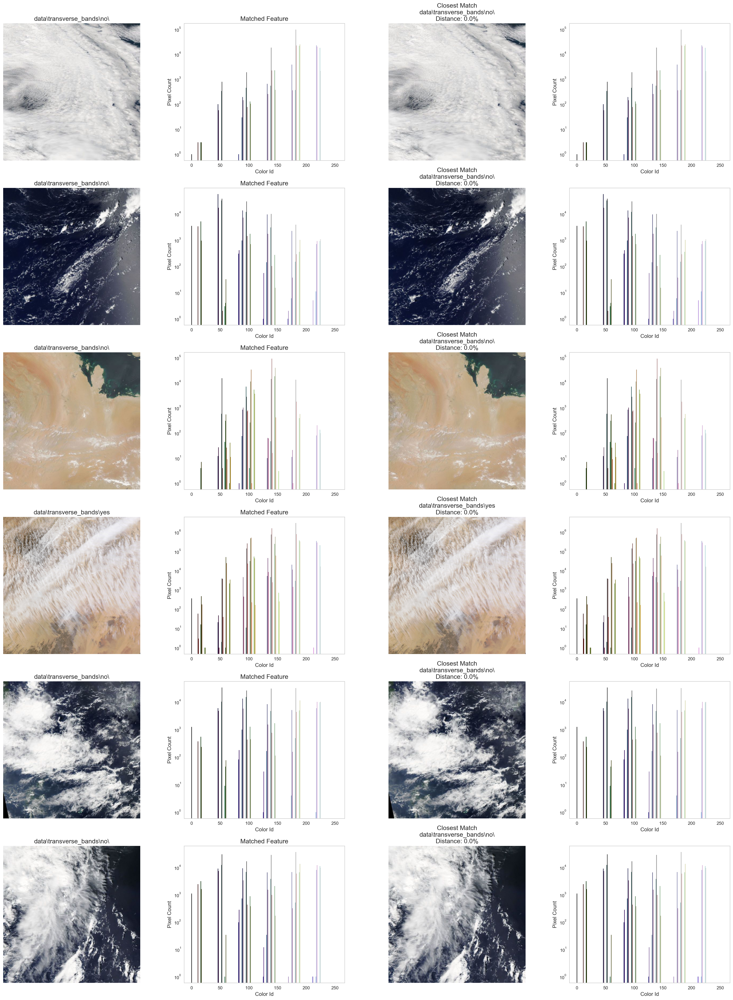

In [32]:
fig, m_axs = plt.subplots(6, 4, figsize=(30, 40))
dummy_web_image = Image.new(size=(1,1), mode='RGB').convert('P', palette='web')

for (c_ax, c_feat_ax, d_ax, d_feat_ax), (_, c_row) in zip(m_axs, 
                            image_df.sample(m_axs.shape[0], random_state=2018).iterrows()):
    
    query_img = Image.open(c_row['path'])
    idx_to_color = np.array(query_img.convert('P', palette='web').getpalette()).reshape((-1, 3))/255.0
    c_ax.imshow(query_img)
    c_ax.set_title(c_row['path'][:25])
    c_ax.axis('off')
    counts, bins = np.histogram(np.ravel(query_img.convert('P', palette='web')), 
                                bins=np.arange(256))
    
    for i in range(counts.shape[0]):
        c_feat_ax.bar(bins[i], counts[i], color=idx_to_color[i], edgecolor='k', linewidth=0.1)
    c_feat_ax.set_yscale('log')
    c_feat_ax.set_xlabel('Color Id')
    c_feat_ax.set_ylabel('Pixel Count')
    c_feat_ax.set_title('Feature Vector')
    
    dist, idx = knn.kneighbors(np.expand_dims(c_row['color_features'], 0))
    m_row = train_df.iloc[idx[0][0]]
    matched_img = Image.open(m_row['path'])
    
    d_ax.imshow(matched_img)
    d_ax.set_title('Closest Match\n{}\nDistance: {:2.1%}'.format(m_row['path'][:25], dist[0][0]))
    d_ax.axis('off')
    
    counts, bins = np.histogram(np.ravel(matched_img.convert('P', palette='web')), 
                                bins=np.arange(256))
    
    for i in range(counts.shape[0]):
        d_feat_ax.bar(bins[i], counts[i], color=idx_to_color[i], edgecolor='k', linewidth=0.1)
    d_feat_ax.set_yscale('log')
    d_feat_ax.set_xlabel('Color Id')
    d_feat_ax.set_ylabel('Pixel Count')
    c_feat_ax.set_title('Matched Feature')

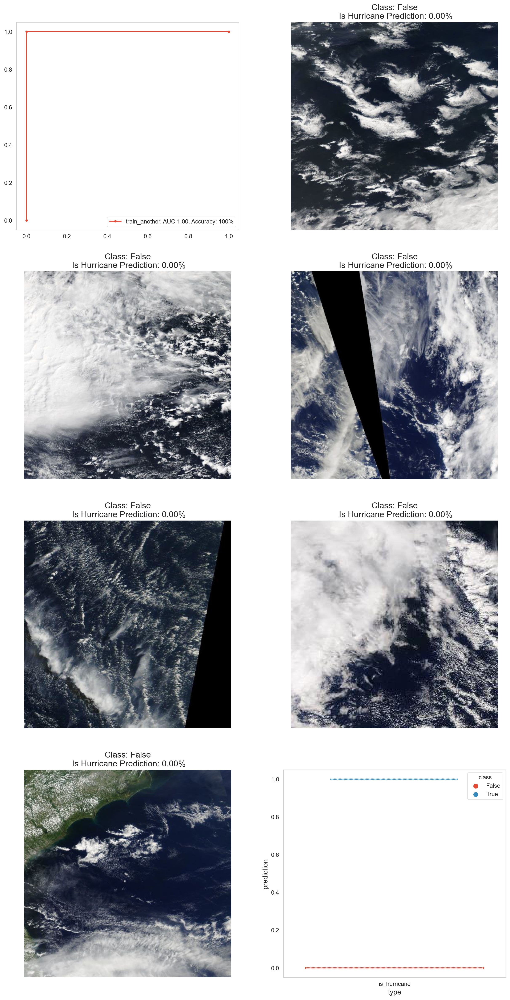

In [33]:
show_model_results(knn);

#  Try other Model

- RandomForest
- XGBoost

#### Random Forest

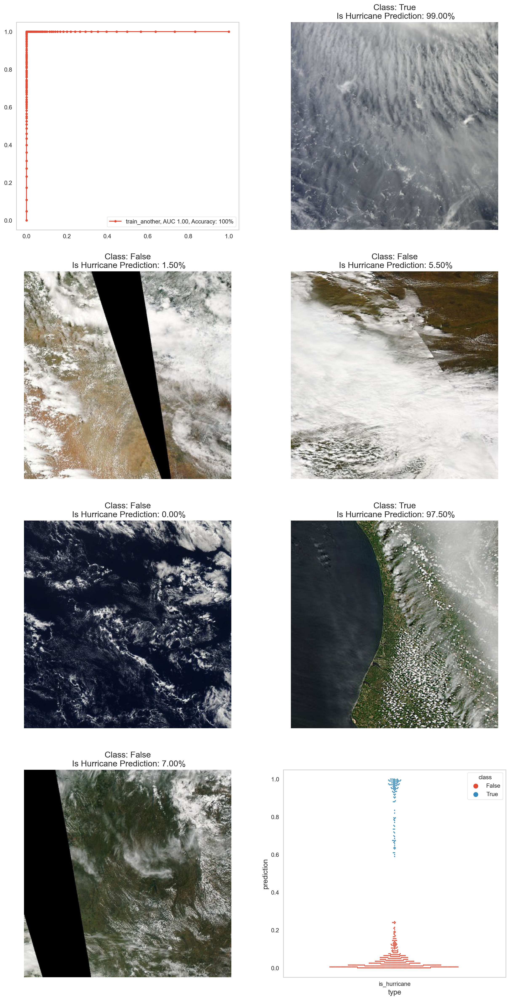

In [68]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import RobustScaler
from sklearn.feature_selection import VarianceThreshold
from sklearn.ensemble import RandomForestRegressor

rf_pipe = make_pipeline(RobustScaler(), RandomForestRegressor(n_estimators=200))
rf_pipe.fit(train_x_vec, train_y_vec)
show_model_results(rf_pipe);

#### XGBoost

In [69]:
from xgboost import XGBRegressor

xg_pipe = make_pipeline(RobustScaler(), 
                        XGBRegressor(objective='reg:linear'))
xg_pipe.fit(train_x_vec, train_y_vec)

[10:41:57] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.2.0/src/objective/regression_obj.cu:174: reg:linear is now deprecated in favor of reg:squarederror.
[10:42:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.2.0/src/objective/regression_obj.cu:174: reg:linear is now deprecated in favor of reg:squarederror.


Pipeline(steps=[('robustscaler', RobustScaler()),
                ('xgbregressor',
                 XGBRegressor(base_score=0.5, booster='gbtree',
                              colsample_bylevel=1, colsample_bynode=1,
                              colsample_bytree=1, gamma=0, gpu_id=-1,
                              importance_type='gain',
                              interaction_constraints='',
                              learning_rate=0.300000012, max_delta_step=0,
                              max_depth=6, min_child_weight=1, missing=nan,
                              monotone_constraints='()', n_estimators=100,
                              n_jobs=0, num_parallel_tree=1,
                              objective='reg:linear', random_state=0,
                              reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
                              subsample=1, tree_method='exact',
                              validate_parameters=1, verbosity=None))])

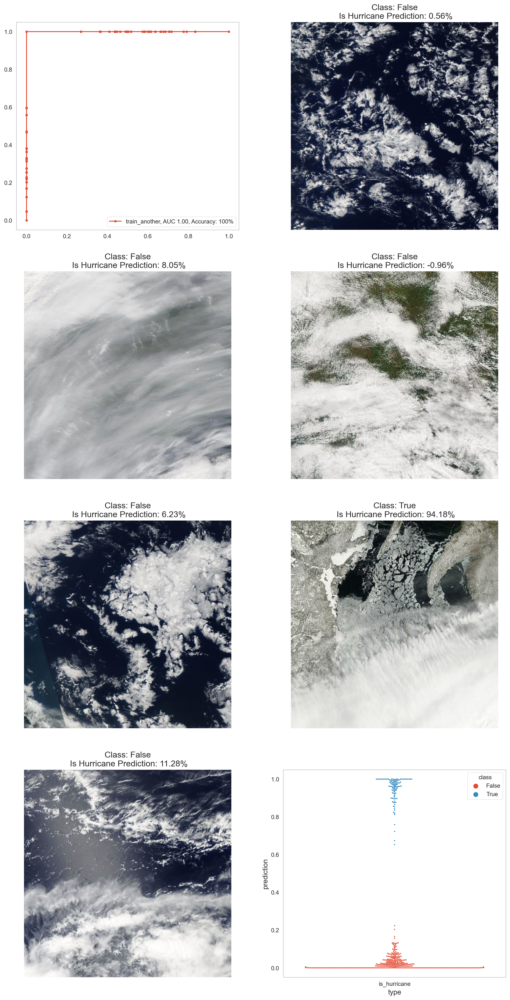

In [70]:
show_model_results(xg_pipe);

###  Test and Predict

In [ ]:
train_x_vec = np.stack(train_df['color_features'].values, 0)

In [42]:
train_df.head()

,index,path,is_hurricane,color_features,x,y,data_split
0,0,data\transverse_bands\no\0_12-2011-07-17-6-0.5...,False,"[0.04955291748046875, 0.0, 0.0, 0.0, 0.0, 0.0,...",-0.131453,0.029544,train_another
1,1,data\transverse_bands\no\0_13-2010-05-12-6-0.2...,False,"[0.001373291015625, 0.0, 0.0, 0.0, 0.0, 0.0, 0...",0.072949,-0.032780,train_another
2,2,data\transverse_bands\no\0_13-2011-07-17-6-0.9...,False,"[0.10449600219726562, 0.0, 0.0, 0.0, 0.0, 0.0,...",-0.176710,0.193282,train_another
3,3,data\transverse_bands\no\0_13-2011-07-19-6-0.1...,False,"[0.002498626708984375, 0.0, 0.0, 0.0, 0.0, 0.0...",-0.175806,0.113762,train_another
4,4,data\transverse_bands\no\0_14-2011-07-17-6-0.9...,False,"[0.06306838989257812, 0.0, 0.0, 0.0, 0.0, 0.0,...",-0.195889,0.188118,train_another


In [58]:
## Get first Element

predictInput = train_df[train_df.index == 5002]
predictInput.head()

,index,path,is_hurricane,color_features,x,y,data_split
5002,5002,data\transverse_bands\yes\bands1499.jpg,True,"[4.57763671875e-05, 0.0, 0.0, 0.0, 0.0, 0.0, 0...",0.148116,-0.006404,train_another


In [61]:
predict_x_vec = np.stack(predictInput['color_features'].values, 0)

## Cross Validation
- Split train and test data

In [238]:
import pandas as pd
from sklearn import datasets, linear_model
from sklearn.model_selection import train_test_split
from matplotlib import pyplot as plt

In [234]:
# Load the Diabetes dataset
columns = "age sex bmi map tc ldl hdl tch ltg glu".split() # Declare the columns names
diabetes = datasets.load_diabetes() # Call the diabetes dataset from sklearn
df = pd.DataFrame(diabetes.data, columns=columns) # load the dataset as a pandas data frame
y = diabetes.target # define the target variable (dependent variable) as y

In [240]:
(X_train, X_test, y_train, y_test) = train_test_split(image_df, 'is_huricane', test_size=0.2)
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)


ValueError: Found input variables with inconsistent numbers of samples: [5144, 11]

In [237]:
(X_train, X_test, y_train, y_test) = train_test_split(df, y, test_size=0.2)
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)


(353, 10) (353,)
(89, 10) (89,)


In [167]:
newDF

,index,path,is_hurricane,color_features,x,y,data_split
5152,5153,img/modis_hazard_3e8429697ddd434bb0ad2ddd3063a...,False,"[0.0006572383320399728, 0.0, 0.0, 0.0, 0.0, 0....",NaN,NaN,predict


### Predict


In [60]:
print(knn.predict(predict_x_vec));

[1.]


In [72]:
print(rf_pipe.predict(predict_x_vec));

[0.985]


In [71]:
print(xg_pipe.predict(predict_x_vec));

[0.9741001]


###  Save Model

In [73]:
import pickle

model_filename = "knn_hurricane.model"

models = {'knn': knn, 'rf_pipe': rf_pipe, 'xg_pipe': xg_pipe}

pickle._dump(models, open(model_filename, 'wb'))

### Reload model

In [75]:
loaded_classifiers = pickle.load(open(model_filename, 'rb'))

print(loaded_classifiers['rf_pipe'].predict(predict_x_vec));

[10:45:17] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.2.0/src/objective/regression_obj.cu:174: reg:linear is now deprecated in favor of reg:squarederror.
[0.985]


# HAZAR-PREDICTION-SERVICE

##### Logic steps

1. Expose Endpoint using Flask

2. Receive Request in JSON

3. Call MODIS to retrieve image for X,Y

4. Run Image by previous Model

5. Return Results in JSON


Contract Request Body:
```json
{
    latitude: 14.021,
    longitude: -124.034,
    predict: [ "hurricane" ]
}
```


#### Flask Endpoint

In [80]:
## Imports
from flask import Flask
from flask import request

In [230]:
app = Flask(__name__)

@app.after_request
def after_request(response):
    response.headers.add('Access-Control-Allow-Origin', '*')
    response.headers.add('Access-Control-Allow-Headers', 'Content-Type,Authorization')
    response.headers.add('Access-Control-Allow-Methods', 'GET,PUT,POST,DELETE')
    return response

@app.route('/hazard/predict', methods=['POST'])
def power():
    if request.headers['Content-Type'] == 'application/json':
        return process_request(request.json)
    else:
        return response("Json record not found in request", 415)

### Start Service



In [231]:
app.run(host='0.0.0.0', port = 8777 )

 * Serving Flask app "__main__" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: off


 * Running on http://0.0.0.0:8777/ (Press CTRL+C to quit)
192.168.1.112 - - [04/Oct/2020 13:18:39] "OPTIONS /hazard/predict HTTP/1.1" 200 -
[2020-10-04 13:18:39,934] ERROR in app: Exception on /hazard/predict [POST]
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 2447, in wsgi_app
    response = self.full_dispatch_request()
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1952, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1821, in handle_user_exception
    reraise(exc_type, exc_value, tb)
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\_compat.py", line 39, in reraise
    raise value
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1950, in full_dispatch_request
    rv = self.dispatch_request()
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1936, in dispatch_reques

Request received: 
{'lat': 26.820833935940016, 'lng': -76.88891249999999, 'predict': ['hurricane']}
Calculating Square Shape...


192.168.1.112 - - [04/Oct/2020 13:20:26] "OPTIONS /hazard/predict HTTP/1.1" 200 -
[2020-10-04 13:20:26,964] ERROR in app: Exception on /hazard/predict [POST]
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 2447, in wsgi_app
    response = self.full_dispatch_request()
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1952, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1821, in handle_user_exception
    reraise(exc_type, exc_value, tb)
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\_compat.py", line 39, in reraise
    raise value
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1950, in full_dispatch_request
    rv = self.dispatch_request()
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1936, in dispatch_request
    return self.view_functions[rule.endpoint](**req.view

Request received: 
{'lat': 26.977596235864578, 'lng': -77.94359999999999, 'predict': ['hurricane']}
Calculating Square Shape...


192.168.1.112 - - [04/Oct/2020 13:21:47] "OPTIONS /hazard/predict HTTP/1.1" 200 -
[2020-10-04 13:21:47,519] ERROR in app: Exception on /hazard/predict [POST]
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 2447, in wsgi_app
    response = self.full_dispatch_request()
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1952, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1821, in handle_user_exception
    reraise(exc_type, exc_value, tb)
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\_compat.py", line 39, in reraise
    raise value
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1950, in full_dispatch_request
    rv = self.dispatch_request()
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1936, in dispatch_request
    return self.view_functions[rule.endpoint](**req.view

Request received: 
{'predict': ['hurricane']}
Calculating Square Shape...


192.168.1.112 - - [04/Oct/2020 13:22:02] "OPTIONS /hazard/predict HTTP/1.1" 200 -
[2020-10-04 13:22:02,668] ERROR in app: Exception on /hazard/predict [POST]
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 2447, in wsgi_app
    response = self.full_dispatch_request()
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1952, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1821, in handle_user_exception
    reraise(exc_type, exc_value, tb)
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\_compat.py", line 39, in reraise
    raise value
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1950, in full_dispatch_request
    rv = self.dispatch_request()
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1936, in dispatch_request
    return self.view_functions[rule.endpoint](**req.view

Request received: 
{'predict': ['hurricane']}
Calculating Square Shape...


192.168.1.112 - - [04/Oct/2020 13:22:08] "OPTIONS /hazard/predict HTTP/1.1" 200 -
[2020-10-04 13:22:08,133] ERROR in app: Exception on /hazard/predict [POST]
Traceback (most recent call last):
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 2447, in wsgi_app
    response = self.full_dispatch_request()
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1952, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1821, in handle_user_exception
    reraise(exc_type, exc_value, tb)
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\_compat.py", line 39, in reraise
    raise value
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1950, in full_dispatch_request
    rv = self.dispatch_request()
  File "C:\ProgramData\Anaconda3\lib\site-packages\flask\app.py", line 1936, in dispatch_request
    return self.view_functions[rule.endpoint](**req.view

Request received: 
{'predict': ['hurricane']}
Calculating Square Shape...


192.168.1.112 - - [04/Oct/2020 13:23:03] "OPTIONS /hazard/predict HTTP/1.1" 200 -


Request received: 
{'latitude': 28.68740583513602, 'longitude': -70.20922499999999, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 23.68740583513602, 'left_longitude': -75.20922499999999, 'higher_latitude': 33.68740583513602, 'right_longitude': -65.20922499999999}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1947 2220


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_5cbe7f9b66d0472ebaf9925a2571c6dd.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.21it/s]
192.168.1.112 - - [04/Oct/2020 13:23:13] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_5cbe7f9b66d0472ebaf9925a2571c...        False   

                                      color_features data_split  
0  [0.001012183215573046, 0.0, 0.0, 0.0, 0.0, 0.0...    predict  
Probability of hurricane:
[0.295]
Response:  {'latitude': 28.68740583513602, 'longitude': -70.20922499999999, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.295}]}


192.168.1.112 - - [04/Oct/2020 13:24:04] "OPTIONS /hazard/predict HTTP/1.1" 200 -


Request received: 
{'latitude': 46.8577108260936, 'longitude': 43.521243750000004, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 41.8577108260936, 'left_longitude': 38.521243750000004, 'higher_latitude': 51.8577108260936, 'right_longitude': 48.521243750000004}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1518 2220


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_1de24215308045b59b96a7541b840851.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.94it/s]
192.168.1.112 - - [04/Oct/2020 13:24:12] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_1de24215308045b59b96a7541b840...        False   

                                      color_features data_split  
0  [0.003659687355339529, 0.0, 0.0, 0.0, 0.0, 0.0...    predict  
Probability of hurricane:
[0.275]
Response:  {'latitude': 46.8577108260936, 'longitude': 43.521243750000004, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.275}]}


192.168.1.112 - - [04/Oct/2020 13:24:49] "OPTIONS /hazard/predict HTTP/1.1" 200 -


Request received: 
{'latitude': 47.097575605637104, 'longitude': 48.618900000000004, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 42.097575605637104, 'left_longitude': 43.618900000000004, 'higher_latitude': 52.097575605637104, 'right_longitude': 53.618900000000004}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1511 2220
Request received: 
{'latitude': 48.630511456944376, 'longitude': 50.025150000000004, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 43.630511456944376, 'left_longitude': 45.025150000000004, 'higher_latitude': 53.630511456944376, 'right_longitude': 55.025150000000004}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1467 2220


192.168.1.112 - - [04/Oct/2020 13:24:55] "OPTIONS /hazard/predict HTTP/1.1" 200 -


Request received: 
{'latitude': 45.98281099373363, 'longitude': 49.849368750000004, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 40.98281099373363, 'left_longitude': 44.849368750000004, 'higher_latitude': 50.98281099373363, 'right_longitude': 54.849368750000004}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1542 2220
Request received: 
{'latitude': 45.98281099373363, 'longitude': 49.849368750000004, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 40.98281099373363, 'left_longitude': 44.849368750000004, 'higher_latitude': 50.98281099373363, 'right_longitude': 54.849368750000004}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1542 2220


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Request received: 
{'latitude': 45.98281099373363, 'longitude': 49.849368750000004, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 40.98281099373363, 'left_longitude': 44.849368750000004, 'higher_latitude': 50.98281099373363, 'right_longitude': 54.849368750000004}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1542 2220
Image PATH:  img/modis_hazard_b718e7f33e3c4715b91c48bc8e46f9b1.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.96it/s]
192.168.1.112 - - [04/Oct/2020 13:24:57] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_b718e7f33e3c4715b91c48bc8e46f...        False   

                                      color_features data_split  
0  [0.0005625413633355393, 0.0, 0.0, 0.0, 0.0, 0....    predict  
Probability of hurricane:
[0.13]
Response:  {'latitude': 47.097575605637104, 'longitude': 48.618900000000004, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.13}]}


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_5e0321adeb7b49df9b377e45821cb996.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.93it/s]
192.168.1.112 - - [04/Oct/2020 13:25:01] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_5e0321adeb7b49df9b377e45821cb...        False   

                                      color_features data_split  
0  [5.772643809453626e-05, 0.0, 0.0, 0.0, 0.0, 0....    predict  
Probability of hurricane:
[0.06]
Response:  {'latitude': 48.630511456944376, 'longitude': 50.025150000000004, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.06}]}


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_31b88bcd80244df99b2187d362d6754d.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.60it/s]
192.168.1.112 - - [04/Oct/2020 13:25:03] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_31b88bcd80244df99b2187d362d67...        False   

                                      color_features data_split  
0  [0.000545097626809689, 0.0, 0.0, 0.0, 0.0, 0.0...    predict  
Probability of hurricane:
[0.115]
Response:  {'latitude': 45.98281099373363, 'longitude': 49.849368750000004, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.115}]}


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_46aaf2313c824ec9811867c03b30e2b5.png  

Predict if in the image is an Hurricane
Image PATH:  img/modis_hazard_4805c282e078431a95adfd40af8e8e49.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.75it/s]
192.168.1.112 - - [04/Oct/2020 13:25:05] "POST /hazard/predict HTTP/1.1" 200 -
100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.96it/s]
192.168.1.112 - - [04/Oct/2020 13:25:05] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_46aaf2313c824ec9811867c03b30e...        False   

                                      color_features data_split  
0  [0.000545097626809689, 0.0, 0.0, 0.0, 0.0, 0.0...    predict  
Probability of hurricane:
[0.115]
Response:  {'latitude': 45.98281099373363, 'longitude': 49.849368750000004, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.115}]}
  index                                               path is_hurricane  \
0   123  img/modis_hazard_4805c282e078431a95adfd40af8e8...        False   

                                      color_features data_split  
0  [0.000545097626809689, 0.0, 0.0, 0.0, 0.0, 0.0...    predict  
Probability of hurricane:
[0.115]
Response:  {'latitude': 45.98281099373363, 'longitude': 49.849368750000004, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.115}]}


192.168.1.112 - - [04/Oct/2020 13:25:26] "OPTIONS /hazard/predict HTTP/1.1" 200 -


Request received: 
{'latitude': 14.818922971285746, 'longitude': -104.13500624999999, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 9.818922971285746, 'left_longitude': -109.13500624999999, 'higher_latitude': 19.818922971285744, 'right_longitude': -99.13500624999999}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
2146 2219


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_ac67f256df0a4cc4a89f005fef975b80.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.23it/s]
192.168.1.112 - - [04/Oct/2020 13:25:37] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_ac67f256df0a4cc4a89f005fef975...        False   

                                      color_features data_split  
0  [0.17179010217191443, 0.0, 0.0, 0.0, 0.0, 0.0,...    predict  
Probability of hurricane:
[0.065]
Response:  {'latitude': 14.818922971285746, 'longitude': -104.13500624999999, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.065}]}


192.168.1.112 - - [04/Oct/2020 13:25:45] "OPTIONS /hazard/predict HTTP/1.1" 200 -


Request received: 
{'latitude': 18.68939977536417, 'longitude': -143.86156874999998, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 13.68939977536417, 'left_longitude': -148.86156874999998, 'higher_latitude': 23.68939977536417, 'right_longitude': -138.86156874999998}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
2102 2220


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_022cebfaedda4e98983efe3534ac9fc0.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.24it/s]
192.168.1.112 - - [04/Oct/2020 13:25:55] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_022cebfaedda4e98983efe3534ac9...        False   

                                      color_features data_split  
0  [0.02873925304943383, 0.0, 0.0, 0.0, 0.0, 0.0,...    predict  
Probability of hurricane:
[0.025]
Response:  {'latitude': 18.68939977536417, 'longitude': -143.86156874999998, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.025}]}


192.168.1.112 - - [04/Oct/2020 13:26:26] "OPTIONS /hazard/predict HTTP/1.1" 200 -


Request received: 
{'latitude': 27.758120234831626, 'longitude': -73.54906874999999, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 22.758120234831626, 'left_longitude': -78.54906874999999, 'higher_latitude': 32.75812023483162, 'right_longitude': -68.54906874999999}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1964 2219


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_962cbe0dffd748ad84dd5e46123bfffe.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.21it/s]
192.168.1.112 - - [04/Oct/2020 13:26:36] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_962cbe0dffd748ad84dd5e46123bf...        False   

                                      color_features data_split  
0  [0.0013693990706075746, 0.0, 0.0, 0.0, 0.0, 0....    predict  
Probability of hurricane:
[0.395]
Response:  {'latitude': 27.758120234831626, 'longitude': -73.54906874999999, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.395}]}


192.168.1.112 - - [04/Oct/2020 13:43:04] "OPTIONS /hazard/predict HTTP/1.1" 200 -


Request received: 
{'latitude': 26.820833935940016, 'longitude': -77.76781874999999, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 21.820833935940016, 'left_longitude': -82.76781874999999, 'higher_latitude': 31.820833935940016, 'right_longitude': -72.76781874999999}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1981 2220


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_61f1ab17ffe0449392ee5b006d29ee14.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.19it/s]
192.168.1.112 - - [04/Oct/2020 13:43:14] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_61f1ab17ffe0449392ee5b006d29e...        False   

                                      color_features data_split  
0  [0.00048160224838670067, 0.0, 0.0, 0.0, 0.0, 0...    predict  
Probability of hurricane:
[0.505]
Response:  {'latitude': 26.820833935940016, 'longitude': -77.76781874999999, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.505}]}


192.168.1.112 - - [04/Oct/2020 13:43:58] "OPTIONS /hazard/predict HTTP/1.1" 200 -


Request received: 
{'latitude': 58.02945199193198, 'longitude': -144.56469374999998, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 53.02945199193198, 'left_longitude': -149.56469374999998, 'higher_latitude': 63.02945199193198, 'right_longitude': -139.56469374999998}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1175 2220


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_a2a16f4bbffa4f0d90fa731532efe340.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  3.67it/s]
192.168.1.112 - - [04/Oct/2020 13:44:04] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_a2a16f4bbffa4f0d90fa731532efe...        False   

                                      color_features data_split  
0  [0.0009867740080506037, 0.0, 0.0, 0.0, 0.0, 0....    predict  
Probability of hurricane:
[0.225]
Response:  {'latitude': 58.02945199193198, 'longitude': -144.56469374999998, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.225}]}


192.168.1.112 - - [04/Oct/2020 13:45:52] "OPTIONS /hazard/predict HTTP/1.1" 200 -


Request received: 
{'latitude': 29.608516697869778, 'longitude': -74.77953749999999, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 24.608516697869778, 'left_longitude': -79.77953749999999, 'higher_latitude': 34.608516697869774, 'right_longitude': -69.77953749999999}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1930 2219


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_19838e447e47497d83bc7d15fb305ac6.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.40it/s]
192.168.1.112 - - [04/Oct/2020 13:46:02] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_19838e447e47497d83bc7d15fb305...        False   

                                      color_features data_split  
0  [0.0004242680383966077, 0.0, 0.0, 0.0, 0.0, 0....    predict  
Probability of hurricane:
[0.19]
Response:  {'latitude': 29.608516697869778, 'longitude': -74.77953749999999, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.19}]}


192.168.1.112 - - [04/Oct/2020 13:49:14] "OPTIONS /hazard/predict HTTP/1.1" 200 -


Request received: 
{'latitude': 28.06877986891735, 'longitude': -73.37328749999999, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 23.06877986891735, 'left_longitude': -78.37328749999999, 'higher_latitude': 33.068779868917346, 'right_longitude': -68.37328749999999}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1958 2219


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_508d5e1c541c4827832fbe9bdeb89495.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.23it/s]
192.168.1.112 - - [04/Oct/2020 13:49:24] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_508d5e1c541c4827832fbe9bdeb89...        False   

                                      color_features data_split  
0  [0.001243324782118955, 0.0, 0.0, 0.0, 0.0, 0.0...    predict  
Probability of hurricane:
[0.4]
Response:  {'latitude': 28.06877986891735, 'longitude': -73.37328749999999, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.4}]}


192.168.1.112 - - [04/Oct/2020 13:50:05] "OPTIONS /hazard/predict HTTP/1.1" 200 -


Request received: 
{'latitude': 29.30239837848313, 'longitude': -78.11938124999999, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 24.30239837848313, 'left_longitude': -83.11938124999999, 'higher_latitude': 34.30239837848313, 'right_longitude': -73.11938124999999}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1935 2220


192.168.1.112 - - [04/Oct/2020 13:50:12] "OPTIONS /hazard/predict HTTP/1.1" 200 -


Request received: 
{'latitude': 62.14328128515289, 'longitude': 2.388431250000007, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 57.14328128515289, 'left_longitude': -2.611568749999993, 'higher_latitude': 67.14328128515288, 'right_longitude': 7.388431250000007}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1037 2219
Request received: 
{'latitude': -20.05933836164968, 'longitude': -4.291256249999993, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': -25.05933836164968, 'left_longitude': -9.291256249999993, 'higher_latitude': -15.05933836164968, 'right_longitude': 0.7087437500000071}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
2085 2220
Request received: 
{'latitude': 46.8577108260936, 'longitude': -134.36938124999998, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 41.8577108260936, 'left_longitude': -139.36938124999998, 'higher_latitude': 51.85771

  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Request received: 
{'latitude': -33.80042285798232, 'longitude': -120.13109999999999, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': -38.80042285798232, 'left_longitude': -125.13109999999999, 'higher_latitude': -28.80042285798232, 'right_longitude': -115.13109999999999}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1844 2220
Image PATH:  img/modis_hazard_c5ec13a0220649d0b40c296afaa6b531.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.17it/s]
192.168.1.112 - - [04/Oct/2020 13:50:16] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_c5ec13a0220649d0b40c296afaa6b...        False   

                                      color_features data_split  
0  [0.001183043508624904, 0.0, 0.0, 0.0, 0.0, 0.0...    predict  
Probability of hurricane:
[0.325]
Response:  {'latitude': 29.30239837848313, 'longitude': -78.11938124999999, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.325}]}
Request received: 
{'latitude': -40.114462568144184, 'longitude': -11.146724999999993, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': -45.114462568144184, 'left_longitude': -16.146724999999993, 'higher_latitude': -35.114462568144184, 'right_longitude': -6.146724999999993}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1697 2220


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_453ea132157c440eb832225ef272d5b1.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  4.38it/s]
192.168.1.112 - - [04/Oct/2020 13:50:19] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_453ea132157c440eb832225ef272d...        False   

                                      color_features data_split  
0  [0.0003667806265082441, 0.0, 0.0, 0.0, 0.0, 0....    predict  
Probability of hurricane:
[0.07]
Response:  {'latitude': 62.14328128515289, 'longitude': 2.388431250000007, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.07}]}


192.168.1.112 - - [04/Oct/2020 13:50:19] "OPTIONS /hazard/predict HTTP/1.1" 200 -


Request received: 
{'latitude': 63.033394583186286, 'longitude': -61.59594374999999, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 58.033394583186286, 'left_longitude': -66.59594374999999, 'higher_latitude': 68.0333945831863, 'right_longitude': -56.59594374999999}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1006 2220


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_1939c683cdaa4fe5916708a298878c56.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.74it/s]
192.168.1.112 - - [04/Oct/2020 13:50:23] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_1939c683cdaa4fe5916708a298878...        False   

                                      color_features data_split  
0  [0.010025044807653503, 0.0, 0.0, 0.0, 0.0, 0.0...    predict  
Probability of hurricane:
[0.275]
Response:  {'latitude': 46.8577108260936, 'longitude': -134.36938124999998, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.275}]}


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_9d5bcf7afb3e4f3a96c3463a2e5f4d54.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.60it/s]
192.168.1.112 - - [04/Oct/2020 13:50:27] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_9d5bcf7afb3e4f3a96c3463a2e5f4...        False   

                                      color_features data_split  
0  [0.1765124116922678, 0.0, 0.0, 0.0, 0.0, 0.0, ...    predict  
Probability of hurricane:
[0.24]
Response:  {'latitude': -20.05933836164968, 'longitude': -4.291256249999993, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.24}]}
Image PATH:  img/modis_hazard_1bdc041d6f1d453889122ee9788f07d7.png  

Predict if in the image is an Hurricane


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  3.37it/s]

Image PATH:  img/modis_hazard_f49a373dd61d4617b1b1cbad28bb4969.png  

Predict if in the image is an Hurricane
Image PATH:  img/modis_hazard_6b42babd54b44b729be108c9a9bd61f8.png  

Predict if in the image is an Hurricane
  index                                               path is_hurricane  \
0   123  img/modis_hazard_1bdc041d6f1d453889122ee9788f0...        False   

                                      color_features data_split  
0  [0.00026462844554295847, 0.0, 0.0, 0.0, 0.0, 0...    predict  



192.168.1.112 - - [04/Oct/2020 13:50:27] "POST /hazard/predict HTTP/1.1" 200 -


Probability of hurricane:
[0.205]
Response:  {'latitude': 63.033394583186286, 'longitude': -61.59594374999999, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.205}]}


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.10it/s]
192.168.1.112 - - [04/Oct/2020 13:50:28] "POST /hazard/predict HTTP/1.1" 200 -
100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.60it/s]
192.168.1.112 - - [04/Oct/2020 13:50:28] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_6b42babd54b44b729be108c9a9bd6...        False   

                                      color_features data_split  
0  [0.00014147913381855633, 0.0, 0.0, 0.0, 0.0, 0...    predict  
Probability of hurricane:
[0.135]
Response:  {'latitude': -40.114462568144184, 'longitude': -11.146724999999993, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.135}]}
  index                                               path is_hurricane  \
0   123  img/modis_hazard_f49a373dd61d4617b1b1cbad28bb4...        False   

                                      color_features data_split  
0  [7.474936976021574e-05, 0.0, 0.0, 0.0, 0.0, 0....    predict  
Probability of hurricane:
[0.55]
Response:  {'latitude': -33.80042285798232, 'longitude': -120.13109999999999, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.55}]}


192.168.1.112 - - [04/Oct/2020 13:52:21] "OPTIONS /hazard/predict HTTP/1.1" 200 -


Request received: 
{'latitude': 52.747398197533684, 'longitude': -50.87328749999999, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 47.747398197533684, 'left_longitude': -55.87328749999999, 'higher_latitude': 57.747398197533684, 'right_longitude': -45.87328749999999}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1343 2220


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_fbab4797e49742f5b432f805b71f7497.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  3.71it/s]
192.168.1.112 - - [04/Oct/2020 13:52:29] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_fbab4797e49742f5b432f805b71f7...        False   

                                      color_features data_split  
0  [0.0058421042039806005, 0.0, 0.0, 0.0, 0.0, 0....    predict  
Probability of hurricane:
[0.09]
Response:  {'latitude': 52.747398197533684, 'longitude': -50.87328749999999, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.09}]}


192.168.1.112 - - [04/Oct/2020 13:52:45] "OPTIONS /hazard/predict HTTP/1.1" 200 -


Request received: 
{'latitude': 43.25856468939019, 'longitude': -38.92016249999999, 'predict': ['hurricane']}
Calculating Square Shape...
Shape:  {'lower_latitude': 38.25856468939019, 'left_longitude': -43.92016249999999, 'higher_latitude': 48.25856468939019, 'right_longitude': -33.92016249999999}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
1616 2220


  0%|                                                                                                                                                                  | 0/1 [00:00<?, ?it/s]

Image PATH:  img/modis_hazard_6437fc1880734f8f8554b4a685c71072.png  

Predict if in the image is an Hurricane


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  2.70it/s]
192.168.1.112 - - [04/Oct/2020 13:52:54] "POST /hazard/predict HTTP/1.1" 200 -


  index                                               path is_hurricane  \
0   123  img/modis_hazard_6437fc1880734f8f8554b4a685c71...        False   

                                      color_features data_split  
0  [4.097538132191598e-05, 0.0, 0.0, 0.0, 0.0, 0....    predict  
Probability of hurricane:
[0.43]
Response:  {'latitude': 43.25856468939019, 'longitude': -38.92016249999999, 'predicted': [{'hazardType': 'hurricane', 'probability': 0.43}]}


### curl example to test endpoint


<code>curl -d '{"latitude":-26.055, "longitude":43.273, "predict": [ "hurricane" ]}' -H "Content-Type: application/json" -X POST http://localhost:8777/hazard/predict
</code>


#### Process Request

In [222]:
def process_request(requestJson):
    print("Request received: ")
    print(requestJson)
    
    # Calculate square shape from the X,Y of the click
    print("Calculating Square Shape...")
    squareShape = calculate_square_shape(requestJson['latitude'],requestJson['longitude'])
    print("Shape: ", squareShape)
    
    # Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
    print("Retrieve & download the MODIS image based on (X,Y,Z,K) parameters")
    imagePath = retrieve_modis_image(squareShape['lower_latitude'], squareShape['left_longitude'],
        squareShape['higher_latitude'], squareShape['right_longitude'])
    print("Image PATH: ",imagePath," \n")
    
    # Predict if in the image is an Hurricane    
    print("Predict if in the image is an Hurricane")
    response = predict_is_hurricane(requestJson['latitude'], requestJson['longitude'], imagePath)
    
    # Response
    print("Response: ",response)
    return response
    

#### Calculate Square shape from point lattitudeX, longitudeY

Result Dimensions: [lower_latitude, left_longitude, higher_latitude, right_longitude]


In [228]:

def calculate_square_shape(lattX,longY):
    clickDistanceToEdge = 5; # measured in coordinate degrees
    
    lower_latitude = lattX - clickDistanceToEdge
    left_longitude = longY - clickDistanceToEdge
    higher_latitude = lattX + clickDistanceToEdge
    right_longitude = longY + clickDistanceToEdge
    
    result = {"lower_latitude":lower_latitude, "left_longitude":left_longitude, 
              "higher_latitude":higher_latitude, "right_longitude":right_longitude}
    
    return result
    

### Retrieve MODIS image

In [187]:
la=51.46162974683544
lo=-22.94768591772153

import uuid
uuid.uuid4()

print( str(uuid.uuid4()))

print( uuid.uuid4().hex)

imageTest = "modis_hazard_%s.png" % (uuid.uuid4().hex)

imageTest

fd787f90-8588-4d45-a8af-f048498a3f59
995b36f798cd4f489c16d2db171e149c


'modis_hazard_c7b883114e77436cb9fc42f1ab611a06.png'

In [224]:
import numpy as np
import requests
import uuid

from io import BytesIO
from matplotlib.pyplot import imshow
from PIL import Image

URL = "https://gibs.earthdata.nasa.gov/wms/epsg4326/best/wms.cgi?SERVICE=WMS&REQUEST=GetMap&layers=MODIS_Aqua_CorrectedReflectance_TrueColor&version=1.3.0&crs=EPSG:4326&transparent=false&width={}&height={}&bbox={}&format=image/tiff&time={}"
KM_PER_DEG_AT_EQ = 111.


# Note: Be careful with the resolution and extent. higher resolution with bigger extent images will be huge
# and probably not load. For the dataset we have 0.25 might be more than enough.
def calculate_width_height(extent, resolution):
    """
    extent: [lower_latitude, left_longitude, higher_latitude, right_longitude],
        EG: [51.46162974683544,-22.94768591772153,53.03698575949367,-20.952234968354432]
    resolution: represents the pixel resolution,
        i.e. km/pixel. Should be a value from this list: [0.03, 0.06, 0.125, 0.25, 0.5, 1, 5, 10]
    """
    lats = extent[::2]
    lons = extent[1::2]
    km_per_deg_at_lat = KM_PER_DEG_AT_EQ * np.cos(np.pi * np.mean(lats) / 180.)
    width = int((lons[1] - lons[0]) * km_per_deg_at_lat / resolution)
    height = int((lats[1] - lats[0]) * KM_PER_DEG_AT_EQ / resolution)
    print(width, height)
    return width, height


def modis_url(time, extent, resolution):
    """
    time: utc time in iso format EG: 2020-02-19T00:00:00Z
    extent: [lower_latitude, left_longitude, higher_latitude, right_longitude],
        EG: [51.46162974683544,-22.94768591772153,53.03698575949367,-20.952234968354432]
    resolution: represents the pixel resolution,
        i.e. km/pixel. Should be a value from this list: [0.03, 0.06, 0.125, 0.25, 0.5, 1, 5, 10]
    """
    width, height = calculate_width_height(extent, resolution)
    extent = ','.join(map(lambda x: str(x), extent))
    return width, height, URL.format(width, height, extent, time)




def retrieve_modis_image(x,y,z,k):
    width, height, url = modis_url('2020-10-03T00:00:00Z',
                               [x,y,z,k],
                               0.5)
    
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    
    #Unique ID generated
    id = uuid.uuid4().hex

    imagePath = "img/modis_hazard_%s.png" % (id)
    
    img.save(imagePath)
    
    return imagePath
    

In [201]:
#Test MODIS
# {'lower_latitude': -56.055, 'left_longitude': 13.273000000000003, 'higher_latitude': 3.9450000000000003, 'right_longitude': 73.273}

retrieve_modis_image(-26.0553, 28.4103, -14.0135, 43.2748)



3100 2673


'img/modis_hazard_a624165e6eb04fcf854117a46276226e.png'

In [208]:
 # Calculate square shape from the X,Y of the click
print("Calculating Square Shape...")
squareShape = calculate_square_shape(-18.123,35.123)
print("Shape: ", squareShape)

# Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
print("Retrieve & download the MODIS image based on (X,Y,Z,K) parameters")
imagePath = retrieve_modis_image(squareShape['lower_latitude'], squareShape['left_longitude'],
    squareShape['higher_latitude'], squareShape['right_longitude'])
print("Image PATH: ",imagePath," \n")

Calculating Square Shape...
Shape:  {'lower_latitude': -20.123, 'left_longitude': 33.123, 'higher_latitude': -16.123, 'right_longitude': 37.123}
Retrieve & download the MODIS image based on (X,Y,Z,K) parameters
843 888
Image PATH:  img/modis_hazard_69af549eda814b849679d98ba3b39448.png  



#### Predict if hurricane 
- Use existing model on the image downloaded
- Decompose the image so that it fits the model input

In [189]:
train_df.head()

,index,path,is_hurricane,color_features,x,y,data_split
0,0,data\transverse_bands\no\0_12-2011-07-17-6-0.5...,False,"[0.04955291748046875, 0.0, 0.0, 0.0, 0.0, 0.0,...",-0.131453,0.029544,train_another
1,1,data\transverse_bands\no\0_13-2010-05-12-6-0.2...,False,"[0.001373291015625, 0.0, 0.0, 0.0, 0.0, 0.0, 0...",0.072949,-0.032780,train_another
2,2,data\transverse_bands\no\0_13-2011-07-17-6-0.9...,False,"[0.10449600219726562, 0.0, 0.0, 0.0, 0.0, 0.0,...",-0.176710,0.193282,train_another
3,3,data\transverse_bands\no\0_13-2011-07-19-6-0.1...,False,"[0.002498626708984375, 0.0, 0.0, 0.0, 0.0, 0.0...",-0.175806,0.113762,train_another
4,4,data\transverse_bands\no\0_14-2011-07-17-6-0.9...,False,"[0.06306838989257812, 0.0, 0.0, 0.0, 0.0, 0.0,...",-0.195889,0.188118,train_another


In [106]:
len(train_df)

5144

In [151]:
%%time
newId = len(train_df)+1

train_df= train_df.append({'index': newId, 'path':'img/modis_hazard_3e8429697ddd434bb0ad2ddd3063a9d9.png', 'is_hurricane': False, 'data_split':'predict' }, ignore_index=True)

train_df.iloc[-1]


Wall time: 6.02 ms


index                                                          5153
path              img/modis_hazard_3e8429697ddd434bb0ad2ddd3063a...
is_hurricane                                                  False
color_features                                                  NaN
x                                                               NaN
y                                                               NaN
data_split                                                  predict
Name: 5152, dtype: object

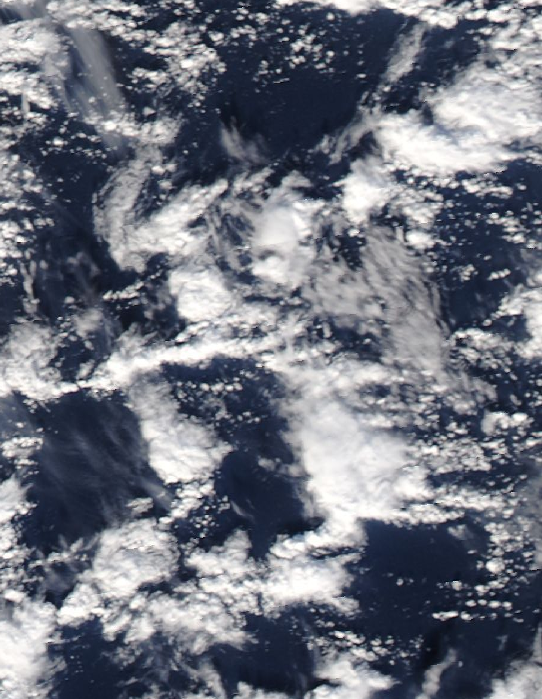

In [152]:
raw_image = Image.open(train_df.iloc[-1]['path'])
raw_image

In [150]:
train_df[train_df['index'] == newId]['path']

5151    img/modis_hazard_3e8429697ddd434bb0ad2ddd3063a...
Name: path, dtype: object

In [166]:
newDF = train_df[train_df['index'] == newId]
newDF
newDF['color_features'] = newDF['path'].progress_map(color_count_feature)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 21.10it/s]
<ipython-input-166-79dd70892b6f>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  newDF['color_features'] = newDF['path'].progress_map(color_count_feature)


In [217]:
def decompose_img(imagePath):
    mock_df = pd.DataFrame( columns=['index', 'path', 'is_hurricane','color_features','data_split'])

    newId = 123
    
    mock_df= mock_df.append({'index': newId, 'path':imagePath, 'is_hurricane': False, 'data_split':'predict' }, ignore_index=True)

    mock_df.iloc[-1]
    
    newDF = mock_df[mock_df['index'] == newId]
    
    newDF['color_features'] = newDF['path'].progress_map(color_count_feature)
    
    return newDF

In [214]:
import pickle

def predict_is_hurricane(latitudeX, longitudeY, imagePath):
    #Load model from saved file
    model_filename = "knn_hurricane.model"
        
    loaded_classifiers = pickle.load(open(model_filename, 'rb'))

    #Decompose image colour features - RGB
    newDF = decompose_img(imagePath)
    print(newDF)
    predict_x_vec = np.stack(newDF['color_features'], 0)
    predicted_probability = loaded_classifiers['rf_pipe'].predict(predict_x_vec)
    
    #Pass the image as input to the model- get probabilty
    print("Probability of hurricane:");
    predicted_probability = loaded_classifiers['rf_pipe'].predict(predict_x_vec)
    print(predicted_probability);
    
    #Format Response
    response = { "latitude": latitudeX, "longitude": longitudeY, "predicted": [ { "hazardType": "hurricane", "probability": predicted_probability[0] }]}
    
    return response

In [215]:
# Test predict function
response = predict_is_hurricane(12.32,123.33,'img/modis_hazard_3e8429697ddd434bb0ad2ddd3063a9d9.png')

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 22.68it/s]

[13:06:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.2.0/src/objective/regression_obj.cu:174: reg:linear is now deprecated in favor of reg:squarederror.
  index                                               path is_hurricane  \
0   123  img/modis_hazard_3e8429697ddd434bb0ad2ddd3063a...        False   

                                      color_features data_split  
0  [0.0006572383320399728, 0.0, 0.0, 0.0, 0.0, 0....    predict  
Probability of hurricane:
[0.195]


In [216]:
response

{'latitude': 12.32,
 'longitude': 123.33,
 'predicted': [{'hazardType': 'hurricane', 'probability': 0.195}]}